In [48]:
import pandas as pd
from pandas.plotting import scatter_matrix
import matplotlib.pyplot as plt
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
%matplotlib inline
import seaborn as sns
import pandas as pd
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix

from sklearn.ensemble import RandomForestClassifier

In [49]:
base=pd.read_csv('file:///F:/datahp/bank.csv')
base.shape

(11162, 17)

In [50]:
base.duplicated().sum()

0

In [51]:
base.isnull().sum().sum()

0

In [52]:
base.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,admin.,married,secondary,no,2343,yes,no,unknown,5,may,1042,1,-1,0,unknown,yes
1,56,admin.,married,secondary,no,45,no,no,unknown,5,may,1467,1,-1,0,unknown,yes
2,41,technician,married,secondary,no,1270,yes,no,unknown,5,may,1389,1,-1,0,unknown,yes
3,55,services,married,secondary,no,2476,yes,no,unknown,5,may,579,1,-1,0,unknown,yes
4,54,admin.,married,tertiary,no,184,no,no,unknown,5,may,673,2,-1,0,unknown,yes


In [53]:
base.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11162 entries, 0 to 11161
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        11162 non-null  int64 
 1   job        11162 non-null  object
 2   marital    11162 non-null  object
 3   education  11162 non-null  object
 4   default    11162 non-null  object
 5   balance    11162 non-null  int64 
 6   housing    11162 non-null  object
 7   loan       11162 non-null  object
 8   contact    11162 non-null  object
 9   day        11162 non-null  int64 
 10  month      11162 non-null  object
 11  duration   11162 non-null  int64 
 12  campaign   11162 non-null  int64 
 13  pdays      11162 non-null  int64 
 14  previous   11162 non-null  int64 
 15  poutcome   11162 non-null  object
 16  deposit    11162 non-null  object
dtypes: int64(7), object(10)
memory usage: 1.4+ MB


In [54]:
base.describe

<bound method NDFrame.describe of        age          job  marital  education default  balance housing loan  \
0       59       admin.  married  secondary      no     2343     yes   no   
1       56       admin.  married  secondary      no       45      no   no   
2       41   technician  married  secondary      no     1270     yes   no   
3       55     services  married  secondary      no     2476     yes   no   
4       54       admin.  married   tertiary      no      184      no   no   
...    ...          ...      ...        ...     ...      ...     ...  ...   
11157   33  blue-collar   single    primary      no        1     yes   no   
11158   39     services  married  secondary      no      733      no   no   
11159   32   technician   single  secondary      no       29      no   no   
11160   43   technician  married  secondary      no        0      no  yes   
11161   34   technician  married  secondary      no        0      no   no   

        contact  day month  duration  cam

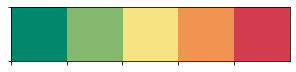

In [55]:
# Esquemas de cores base os gráficos
cols= ['#00876c','#85b96f','#f7e382','#f19452','#d43d51']
sns.palplot(cols)


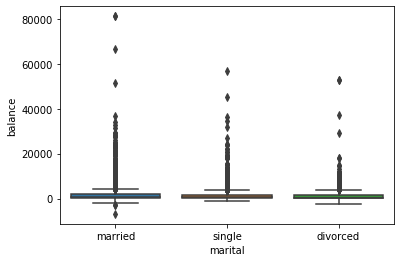

In [56]:
sns.boxplot(x="marital",y="balance", data=base)
plt.show()

In [57]:
df_marital=base[["marital","previous"]]
df_marital.describe().T

,count,mean,std,min,25%,50%,75%,max
previous,11162.0,0.832557,2.292007,0.0,0.0,0.0,1.0,58.0


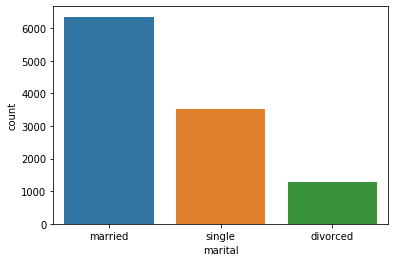

In [58]:
sns.countplot(x="marital",data=base)

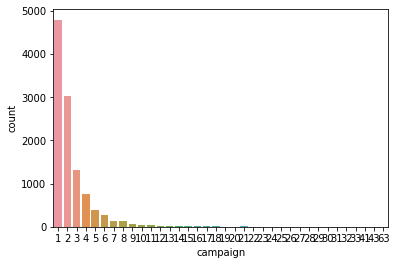

In [59]:
sns.countplot(x="campaign",data=base)

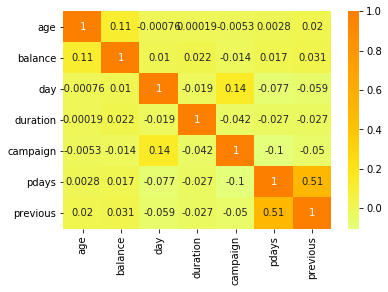

In [60]:
sns.heatmap(base.corr(),annot=True,cmap='Wistia')

In [61]:
previsores =base.iloc[:, 0:16].values
previsores

classe=base.iloc[:,16].values
classe

array(['yes', 'yes', 'yes', ..., 'no', 'no', 'no'], dtype=object)

In [62]:
for i,v in enumerate(classe):
    if v=='yes':
        classe[i]=1
    else:
        classe[i]=0

In [63]:
print(previsores[1])

[56 'admin.' 'married' 'secondary' 'no' 45 'no' 'no' 'unknown' 5 'may'
 1467 1 -1 0 'unknown']


In [64]:
type(previsores)

numpy.ndarray

In [65]:
type(classe)

numpy.ndarray

In [66]:
print(classe[0:101])

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


In [67]:
base.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,admin.,married,secondary,no,2343,yes,no,unknown,5,may,1042,1,-1,0,unknown,1
1,56,admin.,married,secondary,no,45,no,no,unknown,5,may,1467,1,-1,0,unknown,1
2,41,technician,married,secondary,no,1270,yes,no,unknown,5,may,1389,1,-1,0,unknown,1
3,55,services,married,secondary,no,2476,yes,no,unknown,5,may,579,1,-1,0,unknown,1
4,54,admin.,married,tertiary,no,184,no,no,unknown,5,may,673,2,-1,0,unknown,1


In [68]:
from sklearn.preprocessing import LabelEncoder

In [69]:
le=LabelEncoder()
df_col=('job','education')

for i in df_col:
    base[i]=le.fit_transform(base[i])

In [70]:
base.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,0,married,1,no,2343,yes,no,unknown,5,may,1042,1,-1,0,unknown,1
1,56,0,married,1,no,45,no,no,unknown,5,may,1467,1,-1,0,unknown,1
2,41,9,married,1,no,1270,yes,no,unknown,5,may,1389,1,-1,0,unknown,1
3,55,7,married,1,no,2476,yes,no,unknown,5,may,579,1,-1,0,unknown,1
4,54,0,married,2,no,184,no,no,unknown,5,may,673,2,-1,0,unknown,1


In [71]:
x=base.job.values
y=base.education.values

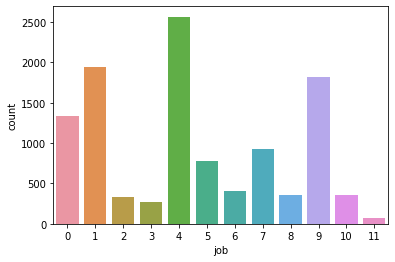

In [72]:
sns.countplot(base['job'])

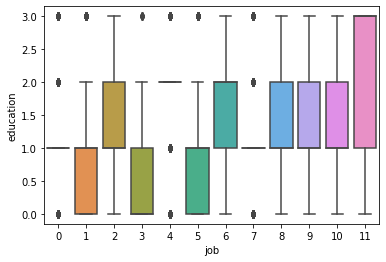

In [73]:
sns.boxplot(x='job',y='education',data=base)

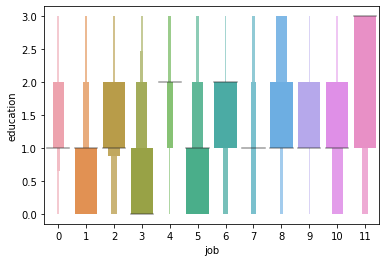

In [74]:
sns.boxenplot(x='job',y='education',data=base)

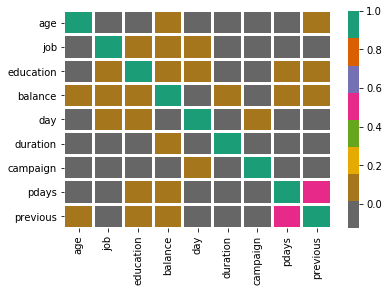

In [75]:
sns.heatmap(base.corr(),cmap='Dark2_r',linewidths=2)

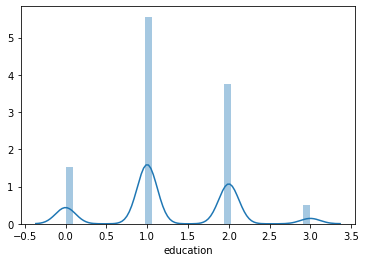

In [76]:
sns.distplot(base['education'])

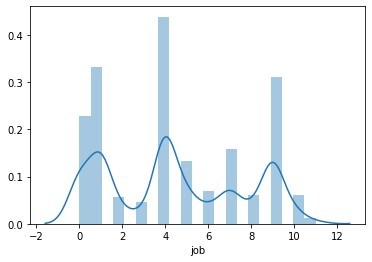

In [77]:
sns.distplot(base['job'])

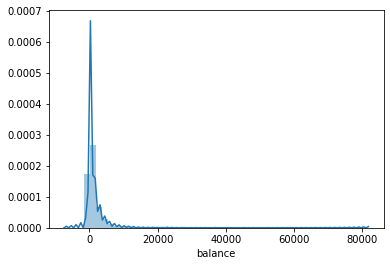

In [78]:
sns.distplot(base['balance'])

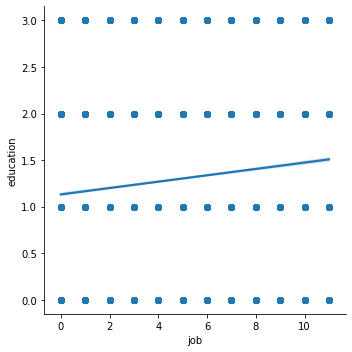

In [79]:
sns.lmplot(x='job',y='education',data=base)

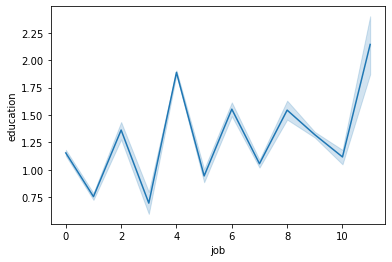

In [80]:
sns.lineplot(x='job',y='education',data=base)

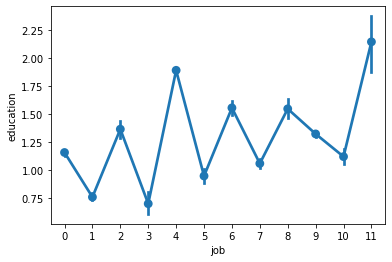

In [81]:
sns.pointplot(x='job',y='education',data=base)

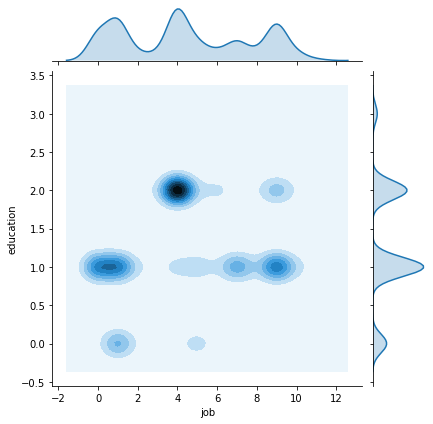

In [82]:
sns.jointplot(x='job',y='education',data=base,kind='kde')

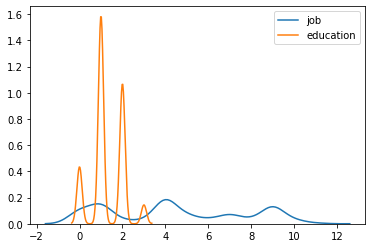

In [83]:
sns.kdeplot(base['job'])
sns.kdeplot(base['education'])

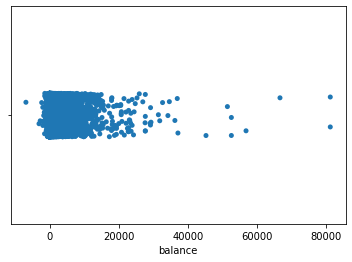

In [84]:
sns.stripplot(base['job'])
sns.stripplot(base['balance'])

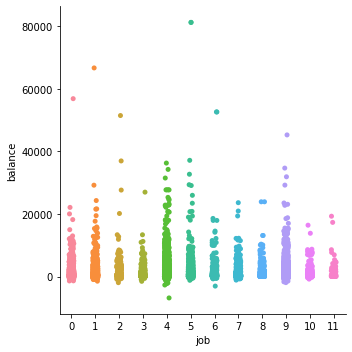

In [85]:
sns.catplot(x='job',y='balance',data=base)

In [86]:
x.shape

(11162,)

In [97]:
y.shape

(11162,)

In [98]:
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.3)

In [99]:
x=x.reshape(-1,1)

In [100]:
y=y.reshape(-1,1)

In [101]:
xtrain,xtest,ytrain,ytest=train_test_split(x,y,test_size=0.3)

In [103]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report

In [105]:
li=LinearRegression()
li.fit(xtrain,ytrain)


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [107]:
li.score(xtest,ytest)*100

0.778803969547015

In [109]:
lo=LogisticRegression()
lo.fit(xtrain,ytrain)
pre_lo=lo.predict(xtest)
accu_lo=accuracy_score(ytest,pre_lo)*100
accu_lo

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


49.23857868020304

In [110]:
print(classification_report(ytest,pre_lo))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       438
           1       0.49      1.00      0.66      1649
           2       0.00      0.00      0.00      1116
           3       0.00      0.00      0.00       146

    accuracy                           0.49      3349
   macro avg       0.12      0.25      0.16      3349
weighted avg       0.24      0.49      0.32      3349



C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [111]:
tre=DecisionTreeClassifier()
tre.fit(xtrain,ytrain)
pre_tre=lo.predict(xtest)
accu_tre=accuracy_score(ytest,pre_tre)*100
accu_tre

49.23857868020304

In [112]:
print(classification_report(ytest,pre_tre))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       438
           1       0.49      1.00      0.66      1649
           2       0.00      0.00      0.00      1116
           3       0.00      0.00      0.00       146

    accuracy                           0.49      3349
   macro avg       0.12      0.25      0.16      3349
weighted avg       0.24      0.49      0.32      3349



C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [113]:
from sklearn.ensemble import RandomForestClassifier

In [114]:
rfc=RandomForestClassifier()
rfc.fit(xtrain,ytrain)
pre_rfc=lo.predict(xtest)
accu_rfc=accuracy_score(ytest,pre_rfc)*100
accu_rfc

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


49.23857868020304

In [115]:
print(classification_report(ytest,pre_tre))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       438
           1       0.49      1.00      0.66      1649
           2       0.00      0.00      0.00      1116
           3       0.00      0.00      0.00       146

    accuracy                           0.49      3349
   macro avg       0.12      0.25      0.16      3349
weighted avg       0.24      0.49      0.32      3349



C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [116]:
from sklearn.naive_bayes import GaussianNB

In [117]:
gnb=GaussianNB()
gnb.fit(xtrain,ytrain)
pre_gnb=lo.predict(xtest)
accu_gnb=accuracy_score(ytest,pre_gnb)*100
accu_gnb

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\sklearn\naive_bayes.py:206: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


49.23857868020304

In [118]:
from sklearn.naive_bayes import BernoulliNB

In [119]:
ber=BernoulliNB()
ber.fit(xtrain,ytrain)
pre_ber=lo.predict(xtest)
accu_ber=accuracy_score(ytest,pre_ber)*100
accu_ber

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


49.23857868020304

In [120]:
from sklearn.svm import SVC

In [121]:
svc=SVC()
svc.fit(xtrain,ytrain)
pre_svc=lo.predict(xtest)
accu_svc=accuracy_score(ytest,pre_svc)*100
accu_svc

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\sklearn\utils\validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


49.23857868020304

In [122]:
from sklearn.ensemble import RandomForestClassifier

In [123]:
rdf=RandomForestClassifier()
rdf.fit(xtrain,ytrain)
pre_rdf=lo.predict(xtest)
accu_rdf=accuracy_score(ytest,pre_rdf)*100
accu_rdf

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


49.23857868020304

In [124]:
base

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,0,married,1,no,2343,yes,no,unknown,5,may,1042,1,-1,0,unknown,1
1,56,0,married,1,no,45,no,no,unknown,5,may,1467,1,-1,0,unknown,1
2,41,9,married,1,no,1270,yes,no,unknown,5,may,1389,1,-1,0,unknown,1
3,55,7,married,1,no,2476,yes,no,unknown,5,may,579,1,-1,0,unknown,1
4,54,0,married,2,no,184,no,no,unknown,5,may,673,2,-1,0,unknown,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11157,33,1,single,0,no,1,yes,no,cellular,20,apr,257,1,-1,0,unknown,0
11158,39,7,married,1,no,733,no,no,unknown,16,jun,83,4,-1,0,unknown,0
11159,32,9,single,1,no,29,no,no,cellular,19,aug,156,2,-1,0,unknown,0
11160,43,9,married,1,no,0,no,yes,cellular,8,may,9,2,172,5,failure,0


In [125]:
import plotly.express as px

In [127]:
fig = px.treemap(base.groupby('job').education.sum().reset_index(), 
                 path=['job'], values='education',
                  color='education', hover_data=['job'],
                  title="Confirmed Indian National per State/UnionTerritory",
                  color_continuous_scale='RdBu')
fig.show()

In [128]:
import sweetviz as sv

In [130]:
data=sv.analyze(base)
data.show_html('Analyze.html')

                                             |          | [  0%]   00:00 -> (? left)

Report Analyze.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [132]:
from IPython.display import IFrame

In [133]:
IFrame(src='Analyze.html',width=1000,height=600)

In [134]:
from dataprep.eda import *

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\dask\dataframe\accessor.py:48: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\dask\dataframe\accessor.py:48: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\dask\dataframe\accessor.py:48: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\dask\dataframe\accessor.py:48: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\dask\dataframe\accessor.py:48: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\dask\dataframe\accessor.py:48: FutureWarning:

The default 

  0%|          | 0/1942 [00:00<?, ?it/s]

C:\Users\Md Asif Ikbal\anaconda3\lib\site-packages\dask\dataframe\accessor.py:48: FutureWarning:

The default value of regex will change from True to False in a future version.



DataPrep Report
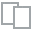
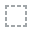
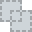
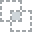
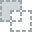
...
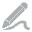
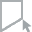
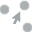
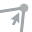
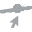

In [135]:
create_report(base)

In [136]:
(base['job'].value_counts().rename('education').to_frame()
 .reset_index().rename({'index': 'job'}, axis=1)
 .style.set_properties(subset=['job'], **{'font-weight': 'bold'})
 .background_gradient(subset='education'))

,job,education
0,4,2566
1,1,1944
2,9,1823
3,0,1334
4,7,923
5,5,778
6,6,405
7,8,360
8,10,357
9,2,328


In [137]:
fig = px.treemap(base.groupby('job').balance.sum().reset_index(), 
                 path=['job'], values='balance',
                  color='balance', hover_data=['job'],
                  title="Confirmed Indian National per State/UnionTerritory",
                  color_continuous_scale='RdBu')
fig.show()

In [138]:
base.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'deposit'],
      dtype='object')

In [139]:
from sklearn.preprocessing import MinMaxScaler